# 1. Data preprocessing

In [1]:
import scvelo as scv
import scanpy as sc
import os.path as op
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sys
sys.path.insert(1, "/Users/smgroves/Documents/GitHub/Groves-CellSys2021/")
import mazebox as mb
import os
import seaborn as sns

In [2]:
indir = "/Users/smgroves/Documents/GitHub/collabs/byers-collaboration/biopsy_updated"
samples = []
for file in os.listdir(indir):
    if ".loom" in file:
        samples.append(file.split(".")[0])
print(samples)

sample_dict = {}
[a1,a2,a3,a4,a5,a6,a7,a8,a9,a10,a11,a12] = [mb.pp.read_loom(sample, indir) for sample in samples]


['SC267_262A_Y905J', 'SC267_162B_E5ZS8', 'SC134_142A_FYKY4', 'SC254_284A_POOVK', 'SC277_288A_SNFU0', 'SC134_145A_43LG5', 'SC324_SC279A_ONADD', 'SC123_135A_5K9UN', 'SC123_140A_6SIM9', 'SC181_151B_WJ6GC', 'SC229_233A_830HW', 'SC307_SC149-A_KRGCG']


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [3]:
batch_categories = samples
batch_key = 'sample'
adatas = [a1,a2, a3,a4,a5,a6,a7, a8, a9, a10, a11, a12] 

a1 = adatas.pop(0)
adata = a1.concatenate(adatas, batch_key=batch_key, batch_categories=batch_categories)

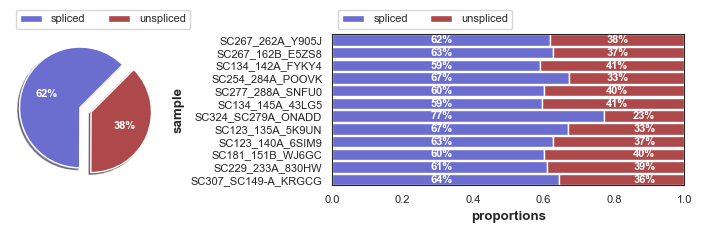

In [4]:
scv.pl.proportions(adata, groupby = 'sample')


In [5]:
adata

AnnData object with n_obs × n_vars = 69154 × 36601
    obs: 'sample'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [6]:
adata.obs

,sample
CellID,
SC267_262A_Y905J:AAATGGAAGCATGAATx-SC267_262A_Y905J,SC267_262A_Y905J
SC267_262A_Y905J:AACAAAGCAGGACTTTx-SC267_262A_Y905J,SC267_262A_Y905J
SC267_262A_Y905J:AAATGGAGTACCGTCGx-SC267_262A_Y905J,SC267_262A_Y905J
SC267_262A_Y905J:AACAACCAGTGTTGAAx-SC267_262A_Y905J,SC267_262A_Y905J
SC267_262A_Y905J:AAAGGGCTCCATAAGCx-SC267_262A_Y905J,SC267_262A_Y905J
...,...
SC307_SC149-A_KRGCG:TTTGGTTGTCCTACAAx-SC307_SC149-A_KRGCG,SC307_SC149-A_KRGCG
SC307_SC149-A_KRGCG:TTTGTTGTCGACGTCGx-SC307_SC149-A_KRGCG,SC307_SC149-A_KRGCG
SC307_SC149-A_KRGCG:TTTGTTGCAACTGCTAx-SC307_SC149-A_KRGCG,SC307_SC149-A_KRGCG


In [7]:
cellid = adata.obs.index
new_index = []
for c in cellid:
    sample = "_".join(c.split("_")[0:2])
    brcd = c.split(":")[1].split("x")[0]
    new_id = sample + "." + brcd + "-1"
    new_index.append(new_id)
    

In [8]:
adata.obs.index = new_index

In [9]:
adata.obs

,sample
SC267_262A.AAATGGAAGCATGAAT-1,SC267_262A_Y905J
SC267_262A.AACAAAGCAGGACTTT-1,SC267_262A_Y905J
SC267_262A.AAATGGAGTACCGTCG-1,SC267_262A_Y905J
SC267_262A.AACAACCAGTGTTGAA-1,SC267_262A_Y905J
SC267_262A.AAAGGGCTCCATAAGC-1,SC267_262A_Y905J
...,...
SC307_SC149-A.TTTGGTTGTCCTACAA-1,SC307_SC149-A_KRGCG
SC307_SC149-A.TTTGTTGTCGACGTCG-1,SC307_SC149-A_KRGCG
SC307_SC149-A.TTTGTTGCAACTGCTA-1,SC307_SC149-A_KRGCG
SC307_SC149-A.TTTGGAGGTTCAACGT-1,SC307_SC149-A_KRGCG


## Compare to MDA preprocessing

In [10]:
mda = sc.read_h5ad(f"{indir}/biopsy_new.h5ad")

In [11]:
mda

AnnData object with n_obs × n_vars = 29841 × 7122
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'S.Score', 'G2M.Score', 'Phase', 'integrated_snn_res.0.1', 'seurat_clusters', 'label', 'cell_id', 'integrated_snn_res.0.05', 'sample_id'
    var: 'features', 'SCT_features'
    uns: 'neighbors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'SCT'
    obsp: 'distances'

In [12]:
len(set(mda.obs.index).intersection(set(adata.obs.index)))

29841

In [13]:
adata_mda = adata[mda.obs.index,:]

### Gene overlap

In [14]:
mb.pp.scanpy_recipe(adata_mda,retain_genes=[mda.var.index], min_genes = 100, min_cells = 3)


Trying to set attribute `.obs` of view, copying.


Filtered out 7175 genes that are detected in less than 3 cells (spliced).
Normalized count data: X, spliced, unspliced.
Logarithmized X.


AnnData object with n_obs × n_vars = 29841 × 29426
    obs: 'sample', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [15]:
len(set(mda.var.index).intersection(set(adata_mda.var.index)))

7099

In [16]:
set(mda.var.index).difference(set(adata_mda.var.index))

{'AC006141.1',
 'AC016831.5',
 'CCDC71L',
 'EID3',
 'GABPB1-IT1',
 'HSPA14.1',
 'MATR3.1',
 'MT-ATP6',
 'MT-ATP8',
 'MT-CO1',
 'MT-CO2',
 'MT-CO3',
 'MT-CYB',
 'MT-ND1',
 'MT-ND2',
 'MT-ND3',
 'MT-ND4',
 'MT-ND4L',
 'MT-ND5',
 'MT-ND6',
 'NSMCE3',
 'PIGM',
 'Z83843.1'}

In [17]:
gene_subset = list(set(mda.var.index).intersection(set(adata_mda.var.index)))

In [18]:
adata_mda = adata_mda[:,gene_subset]

In [19]:
adata_mda.obs = adata_mda.obs.merge(mda.obs, how = "left", left_index = True, right_index = True)

In [20]:
adata_mda

AnnData object with n_obs × n_vars = 29841 × 7099
    obs: 'sample', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'S.Score', 'G2M.Score', 'Phase', 'integrated_snn_res.0.1', 'seurat_clusters', 'label', 'cell_id', 'integrated_snn_res.0.05', 'sample_id'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [21]:
mda

AnnData object with n_obs × n_vars = 29841 × 7122
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'S.Score', 'G2M.Score', 'Phase', 'integrated_snn_res.0.1', 'seurat_clusters', 'label', 'cell_id', 'integrated_snn_res.0.05', 'sample_id'
    var: 'features', 'SCT_features'
    uns: 'neighbors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'SCT'
    obsp: 'distances'

In [22]:
adata_mda.obsm = mda.obsm
adata_mda.obsp = mda.obsp


In [27]:
adata_mda.layers['SCT'] = mda[:,gene_subset].layers['SCT']

In [28]:
adata_mda.write_h5ad("../biopsy_updated/adata_mda_01.h5ad")

... storing 'orig.ident' as categorical
... storing 'Phase' as categorical
... storing 'label' as categorical
... storing 'cell_id' as categorical
... storing 'sample_id' as categorical


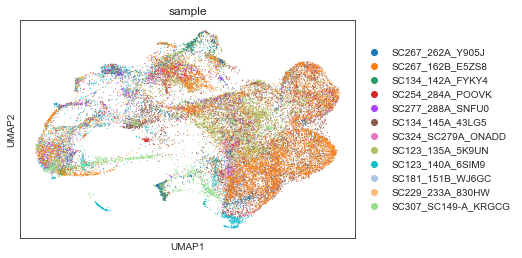

In [31]:
sc.pl.umap(adata_mda, color = 'sample')

### Add metadata

In [43]:
meta = pd.DataFrame(index = adata_mda.obs.index)
for file in os.listdir(indir):
    if ".csv" in file:
        if "score" in file: 
            f = pd.read_csv(f"{indir}/{file}", index_col = 0)
            name = file.split(".")[0]

            meta[name] = f['x'] 
        


In [53]:
yap1_cells = pd.read_csv(f"{indir}/yap1_cells.csv", index_col = 0)
yap1_cells.head()

,x
1,SC123_135A.AAACCCATCACCTCTG-1
2,SC123_135A.AAACCCATCAGAACCT-1
3,SC123_135A.AAACGAAGTCTCAGGC-1
4,SC123_135A.AAACGAATCACCACAA-1
5,SC123_135A.AAACGAATCGAGATAA-1


In [72]:
yap1p = []

for i in meta.index:
    if i in yap1_cells['x'].values: 
        yap1p.append("True")
    else: 
        yap1p.append("False")


In [73]:
meta['yap1_pos'] = yap1p

In [74]:
mycp = []
myc_cells = pd.read_csv(f"{indir}/myc_cells.csv", index_col = 0)
for i in meta.index:
    if i in myc_cells['x'].values: 
        mycp.append("True")
    else: 
        mycp.append("False")

In [75]:
meta['myc_pos'] = mycp

In [76]:
meta

,YAPTAZ_score,EMT_score,yap1_pos,myc_pos
SC123_135A.AAACCCACAAAGGCTG-1,-5.056734,-0.826256,False,True
SC123_135A.AAACCCACAGCGGATA-1,2.991643,-0.923890,False,True
SC123_135A.AAACCCAGTGTCCGGT-1,3.082395,-1.067285,False,True
SC123_135A.AAACCCATCACCTCTG-1,10.000000,-0.944073,True,True
SC123_135A.AAACCCATCAGAACCT-1,6.861922,-0.903721,True,True
...,...,...,...,...
SC324_SC279A.TTGTTGTTCTGAATGC-1,-10.092705,-1.177377,False,True
SC324_SC279A.TTTACCATCCATTGCC-1,-3.493524,0.043269,False,False
SC324_SC279A.TTTACCATCTGCGGAC-1,-0.602974,-0.290549,False,False
SC324_SC279A.TTTCATGGTAGTATAG-1,-8.112427,-0.736782,False,True


In [87]:
adata_mda.obs = adata_mda.obs.merge(meta, how = "left", left_index = True, right_index = True)

In [88]:
adata_mda.obs

,sample,n_genes,initial_size_spliced,initial_size_unspliced,initial_size,n_counts,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,...,yap1_pos_x,myc_pos_x,YAPTAZ_score_y,EMT_score_y,yap1_pos_y,myc_pos_y,YAPTAZ_score,EMT_score,yap1_pos,myc_pos
SC123_135A.AAACCCACAAAGGCTG-1,SC123_135A_5K9UN,3932,14793,3828,14793.0,6186.000000,SC123,20806.0,4567,2.249351,...,False,True,-5.056734,-0.826256,False,True,-5.056734,-0.826256,False,True
SC123_135A.AAACCCACAGCGGATA-1,SC123_135A_5K9UN,3599,13224,4102,13224.0,6186.000000,SC123,19024.0,4207,2.533642,...,False,True,2.991643,-0.923890,False,True,2.991643,-0.923890,False,True
SC123_135A.AAACCCAGTGTCCGGT-1,SC123_135A_5K9UN,4470,16240,8151,16240.0,6186.000000,SC123,24116.0,5158,2.840438,...,False,True,3.082395,-1.067285,False,True,3.082395,-1.067285,False,True
SC123_135A.AAACCCATCACCTCTG-1,SC123_135A_5K9UN,4876,18796,7797,18796.0,6185.999512,SC123,27335.0,5580,3.146150,...,True,True,10.000000,-0.944073,True,True,10.000000,-0.944073,True,True
SC123_135A.AAACCCATCAGAACCT-1,SC123_135A_5K9UN,3901,12287,6235,12287.0,6185.999023,SC123,17414.0,4596,2.653038,...,True,True,6.861922,-0.903721,True,True,6.861922,-0.903721,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SC324_SC279A.TTGTTGTTCTGAATGC-1,SC324_SC279A_ONADD,6077,45052,13852,45052.0,6185.725586,SC324,64823.0,6952,7.347701,...,False,True,-10.092705,-1.177377,False,True,-10.092705,-1.177377,False,True
SC324_SC279A.TTTACCATCCATTGCC-1,SC324_SC279A_ONADD,512,722,268,722.0,6186.000977,SC324,996.0,637,1.506024,...,False,False,-3.493524,0.043269,False,False,-3.493524,0.043269,False,False
SC324_SC279A.TTTACCATCTGCGGAC-1,SC324_SC279A_ONADD,656,1019,59,1019.0,6186.000000,SC324,1335.0,775,3.370787,...,False,False,-0.602974,-0.290549,False,False,-0.602974,-0.290549,False,False
SC324_SC279A.TTTCATGGTAGTATAG-1,SC324_SC279A_ONADD,2984,11502,1834,11502.0,6185.999512,SC324,15457.0,3509,3.144207,...,False,True,-8.112427,-0.736782,False,True,-8.112427,-0.736782,False,True


In [89]:
adata_mda.write_h5ad("../biopsy_updated/adata_mda_01.h5ad")

... storing 'yap1_pos' as categorical
... storing 'myc_pos' as categorical


Update UMAP to match byers group

In [92]:
# umap = pd.read_csv(f"{indir}/umap.csv", index_col = 0)
# umap.head()

,UMAP_1,UMAP_2
SC123_135A.AAACCCACAAAGGCTG-1,2.024495,-0.947234
SC123_135A.AAACCCACAGCGGATA-1,0.050355,-0.834010
SC123_135A.AAACCCAGTGTCCGGT-1,2.456865,-1.948669
SC123_135A.AAACCCATCACCTCTG-1,1.271354,-0.849997
SC123_135A.AAACCCATCAGAACCT-1,-0.188911,-0.037420


In [96]:
# adata_mda.obsm['X_umap_mda'] = np.array(umap) 

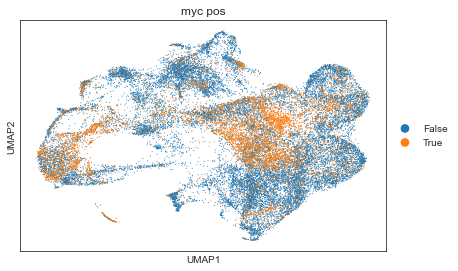

In [98]:
sc.pl.scatter(adata_mda, color = 'myc_pos', basis = 'umap')

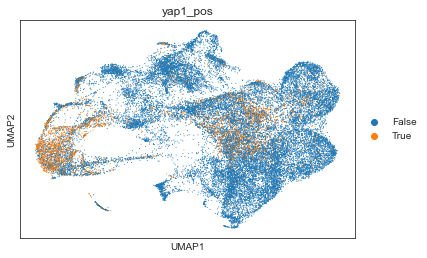

In [91]:
sc.pl.umap(adata_mda, color = 'yap1_pos')

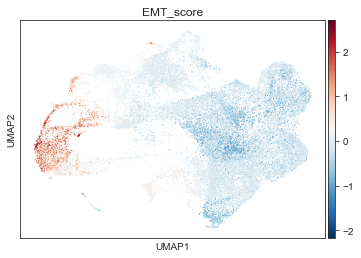

In [104]:
sc.pl.umap(adata_mda, color = 'EMT_score', cmap = 'RdBu_r')

In [107]:
adata_mda.write_h5ad("../biopsy_updated/adata_mda_01.h5ad")

# 2. Velocity and plasticity analysis

In [2]:
import cellrank as cr
import scanorama
from typing import Any
from copy import copy
from anndata import AnnData
import scipy.sparse as sp
from cellrank.tl.kernels import VelocityKernel
import warnings

warnings.simplefilter("ignore", category=UserWarning)
warnings.simplefilter("ignore", category=FutureWarning)
warnings.simplefilter("ignore", category=DeprecationWarning)

In [3]:
class MyKernel(cr.tl.kernels.Kernel):
    def __init__(
        self, adata: AnnData, obs_key: str = "Diffusion Pseudotime", **kwargs: Any
    ):
        super().__init__(adata=adata, obs_key=obs_key, **kwargs)

    def _read_from_adata(self, obs_key: str, **kwargs: Any) -> None:
        super()._read_from_adata(**kwargs)

        print(f"Reading `adata.obs[{obs_key!r}]`")
        self.pseudotime = self.adata.obs[obs_key].values

    def compute_transition_matrix(self, some_parameter: float = 0.5) -> "MyKernel":
        print("Accessing `.pseudotime`: ", self.pseudotime)
        transition_matrix = sp.diags(
            (some_parameter,) * len(self.adata), dtype=np.float64
        )

        self._compute_transition_matrix(transition_matrix)

        return self

    def copy(self) -> "MyKernel":
        return copy(self)

In [108]:
scv.pp.neighbors(adata_mda) 
scv.pp.moments(adata_mda)
# scv.tl.velocity(adata, mode = 'deterministic', groupby='cline')
# scv.tl.velocity_graph(adata)
scv.tl.recover_dynamics(adata_mda, n_jobs=8) #uses velocity genes from deterministic model as default
scv.tl.velocity(adata_mda, mode="dynamical", groupby = 'sample')
scv.tl.velocity_graph(adata_mda)

computing neighbors


OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


    finished (0:00:11) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:20) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
recovering dynamics (using 8/16 cores)


  0%|          | 0/1488 [00:00<?, ?gene/s]

    finished (0:13:53) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:50) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/16 cores)


  0%|          | 0/29841 [00:00<?, ?cells/s]

    finished (0:02:31) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)
saving figure to file figures/confidence.png


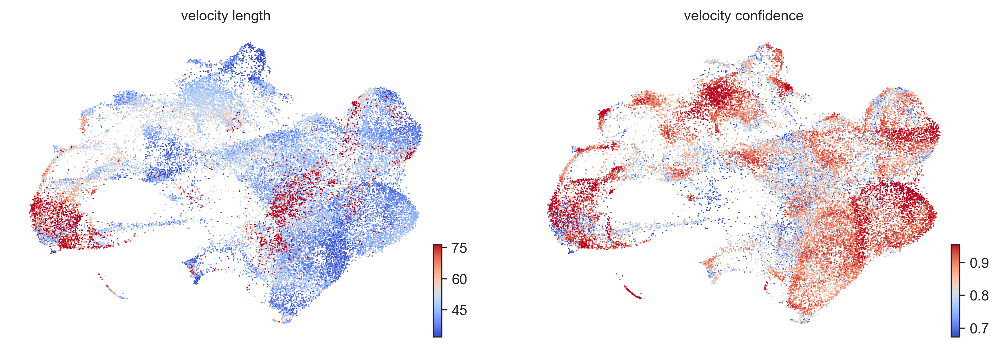

In [109]:
scv.tl.velocity_confidence(adata_mda)

keys = 'velocity_length', 'velocity_confidence'  
scv.pl.scatter(adata_mda, c=keys, cmap='coolwarm', perc=[5, 95], basis = 'umap',
                 dpi = 300, save = 'figures/confidence.png')

computing velocity embedding
    finished (0:00:07) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file figures/sample_velocity_grid.png


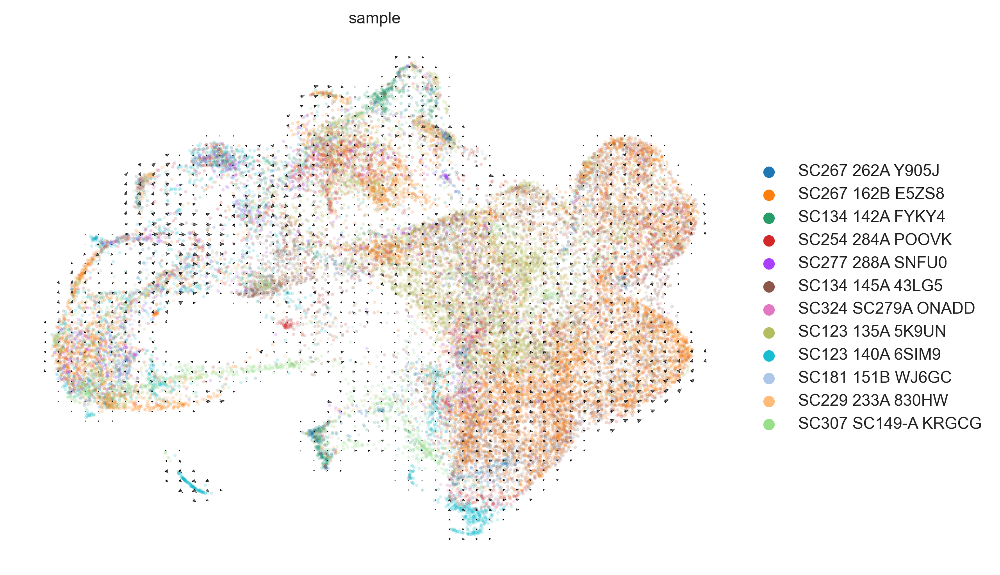

In [110]:
scv.pl.velocity_embedding_grid(adata_mda, vkey='velocity',basis = 'umap', figsize = (8,6), legend_loc = 'on right',color = 'sample',
                              dpi = 300, save = 'figures/sample_velocity_grid.png')

In [114]:
adata_mda.obs = adata_mda.obs.drop(['YAPTAZ_score_x', 'EMT_score_x', 'yap1_pos_x', 'myc_pos_x', 'YAPTAZ_score_y', 'EMT_score_y', 'yap1_pos_y', 'myc_pos_y'], axis = 1)

In [115]:
adata_mda.write_h5ad("../biopsy_updated/adata_mda_02.h5ad")

## Kinetic parameters

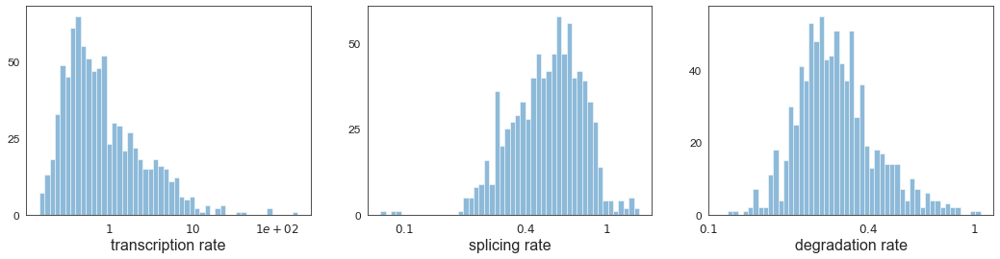

,fit_r2,fit_alpha,fit_beta,fit_gamma,fit_t_,fit_scaling,fit_std_u,fit_std_s,fit_likelihood,fit_u0,fit_s0,fit_pval_steady,fit_steady_u,fit_steady_s,fit_variance,fit_alignment_scaling
Gene,,,,,,,,,,,,,,,,
GARS,0.063369,0.387108,0.697475,0.220543,8.680025,0.729655,0.220401,0.382360,0.113645,0.0,0.0,0.489390,0.998128,1.180932,3.577917,2.580586
IBTK,0.645920,1.609792,0.713539,0.681541,6.687944,0.545679,0.567915,0.491754,0.224730,0.0,0.0,0.489980,1.862153,1.533580,0.967495,1.213519
AKAP17A,0.036108,0.427288,4.312444,0.268660,7.118076,0.233799,0.039974,0.282108,0.097606,0.0,0.0,0.475849,0.145262,1.084418,3.064890,1.718329
GMFG,0.026913,0.915663,2.554938,0.316875,3.099419,0.415909,0.102743,0.402046,0.058730,0.0,0.0,0.492704,0.397430,1.145489,2.167695,1.378429
NOC3L,0.041662,0.295778,1.995141,0.225639,6.543093,0.346619,0.057780,0.253794,0.134735,0.0,0.0,0.472117,0.213249,0.806567,2.352067,2.201566


In [117]:
df = adata_mda.var
df = df[(df['fit_likelihood'] > .1) & df['velocity_genes'] == True]

kwargs = dict(xscale='log', fontsize=16)
with scv.GridSpec(ncols=3) as pl:
    pl.hist(df['fit_alpha'], xlabel='transcription rate', **kwargs)
    pl.hist(df['fit_beta'] * df['fit_scaling'], xlabel='splicing rate', xticks=[.1, .4, 1], **kwargs)
    pl.hist(df['fit_gamma'], xlabel='degradation rate', xticks=[.1, .4, 1], **kwargs)

scv.get_df(adata_mda, 'fit*', dropna=True).head()

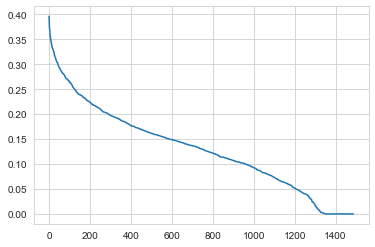

In [125]:
df = scv.get_df(adata_mda, 'fit*', dropna=True).sort_values('fit_likelihood', ascending=False)
df2 = df[ 'fit_likelihood'] #take only fit_like column
df2.to_csv('FL.csv', header=None, sep='\t') #save df to csv
sns.set_style('whitegrid')
plt.plot(range(len(df.index)), df.fit_likelihood)
plt.savefig('./figures/fit_likelihoods_cdf.pdf')

In [126]:
for i in df.index:
    if df.loc[i, 'fit_likelihood'] > 0.3:
        print(i) 
    else: break

NFIA
PDS5B
FAF1
PRKDC
PKIA
CDKAL1
RBBP8
ENAH
PSIP1
RNF24
KIF21A
GMPS
RTN3
AUTS2
ANKRD10
NIPSNAP2
RAB3IP
EPB41
MNAT1
VRK1
ZFHX3
CHD7
ZC2HC1A
GSE1
PCM1
TFDP2
SHTN1
TMEM14B
ATRX
HDAC2
KATNAL1
DPYSL2
MTHFD1
HACD3
MSH2
TPD52
SPIN1
CBFA2T2
EPB41L3
DAAM1
SRPK1
NAV1
LPGAT1
QRSL1


In [ ]:
#https://maayanlab.cloud/Enrichr/enrich?dataset=3743e4297a03e174def5cb450b50d91e

## Plotting velocities

In [4]:
adata_mda = sc.read_h5ad("../biopsy_updated/adata_mda_02.h5ad")

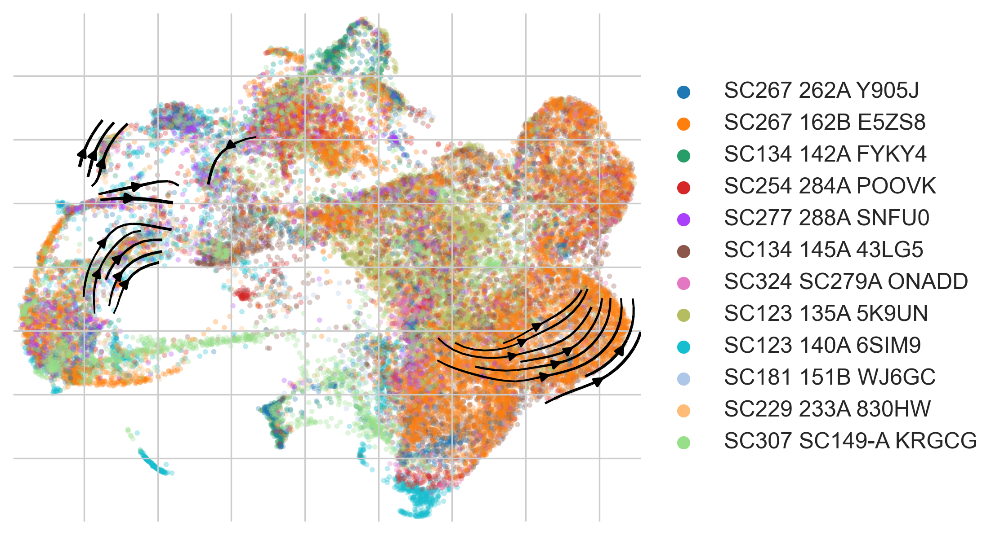

In [129]:
scv.pl.velocity_embedding_stream(
    adata_mda, basis="umap", color = ['sample'], legend_fontsize=12, title="", smooth=0.8, min_mass=4, 
    legend_loc = 'on right', dpi = 300, figsize = (6,5),
    # save = 'figures/scvelo_/by-timepoint/velocity-independent/subtypes_arcs_stream.png'
)

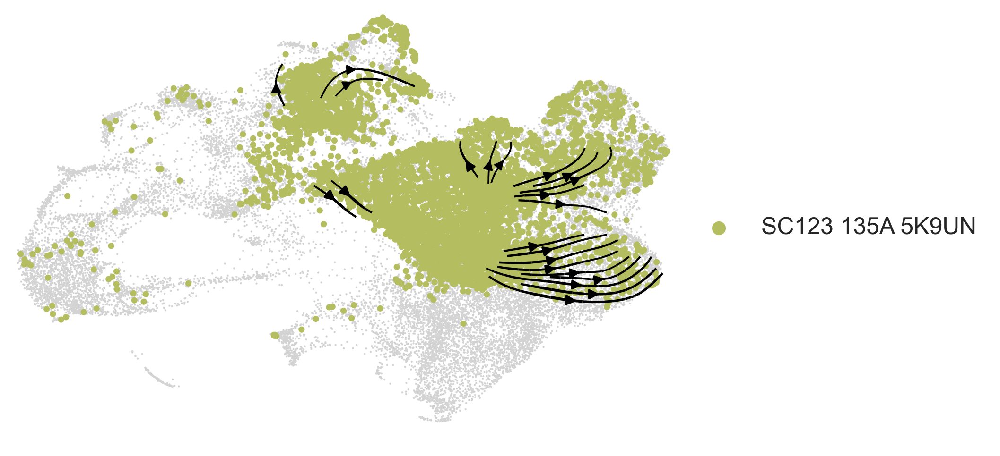

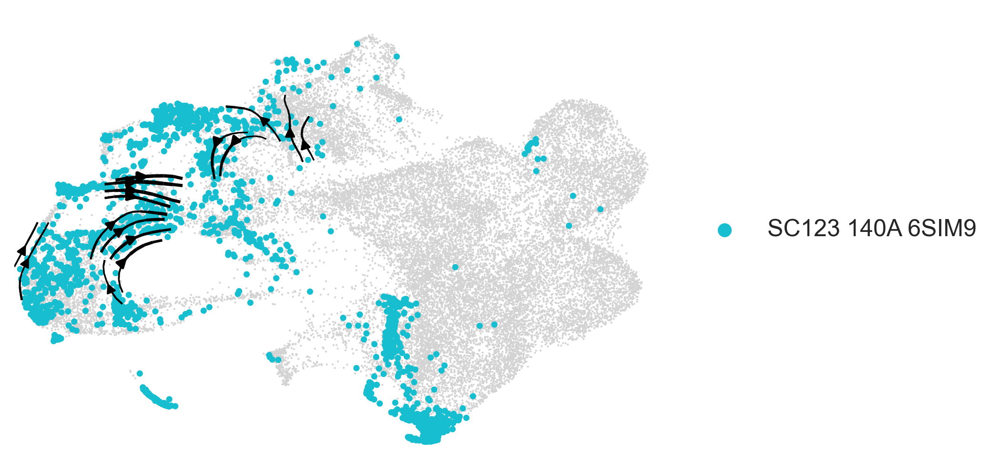

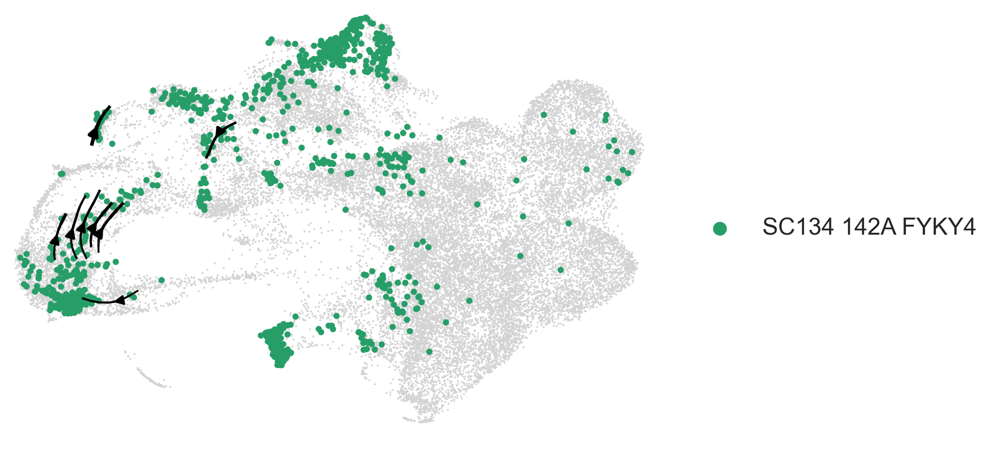

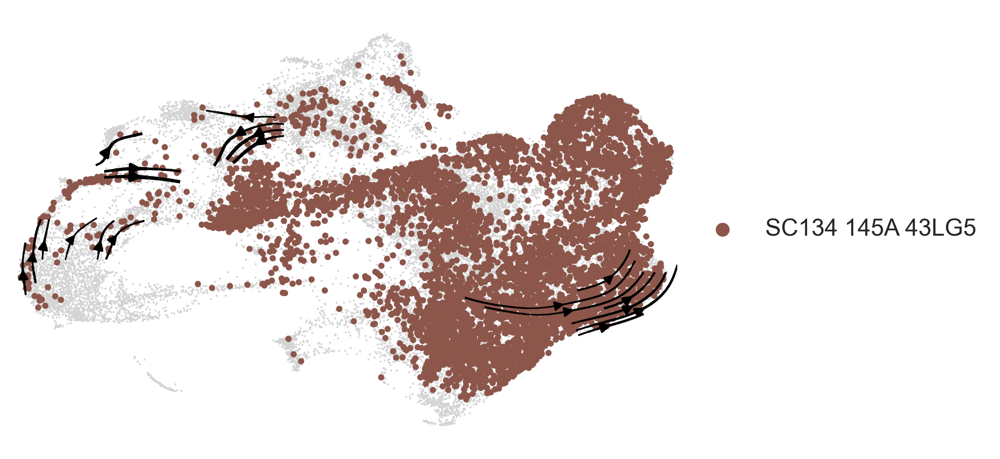

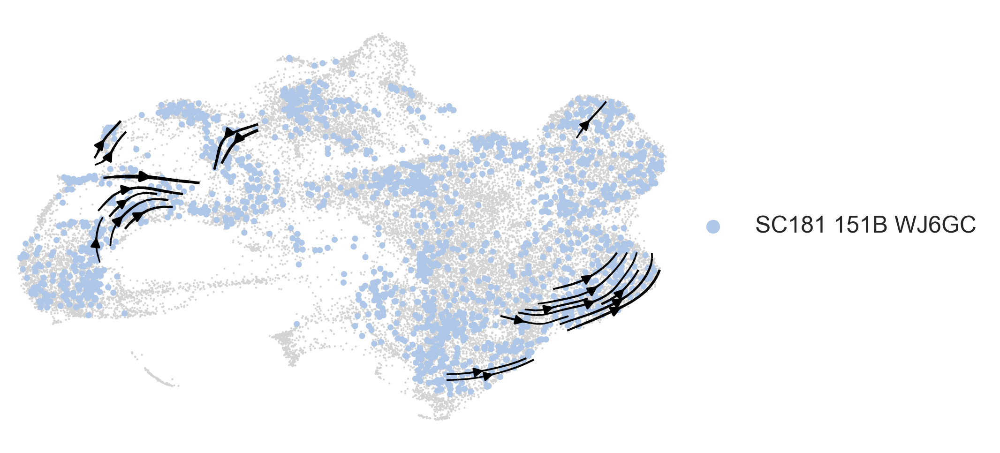

...

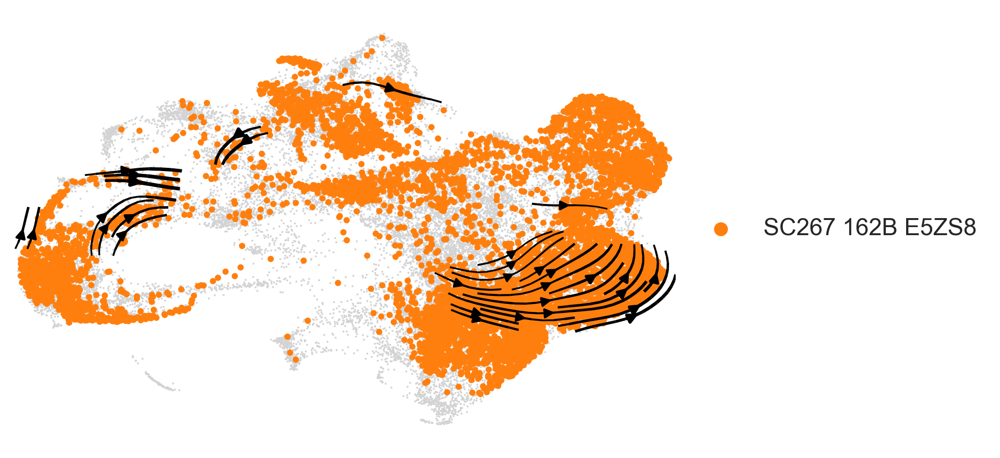

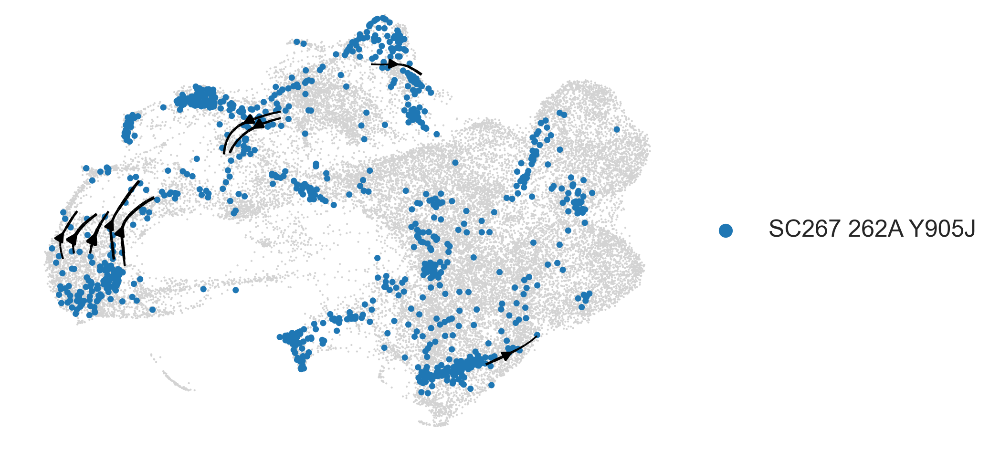

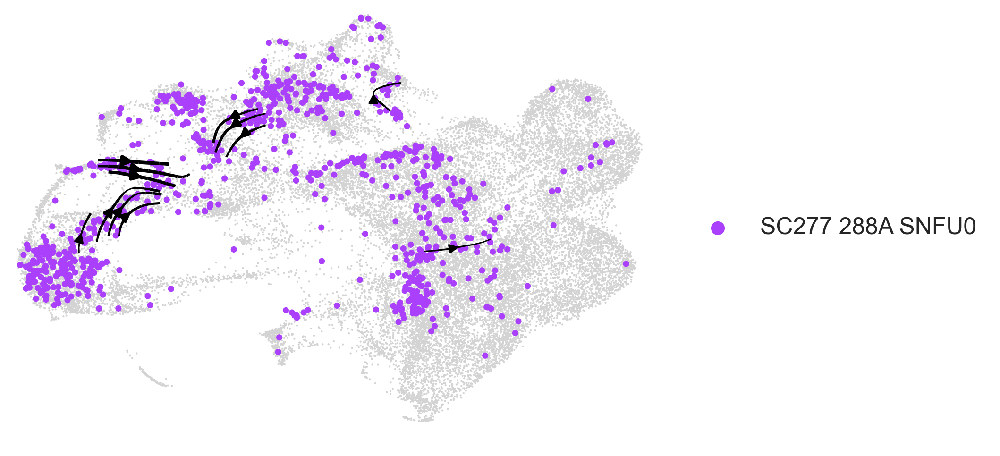

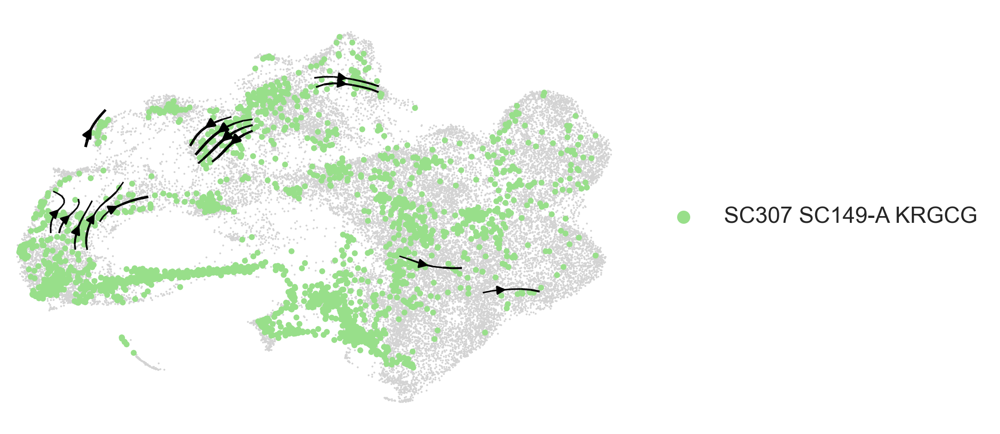

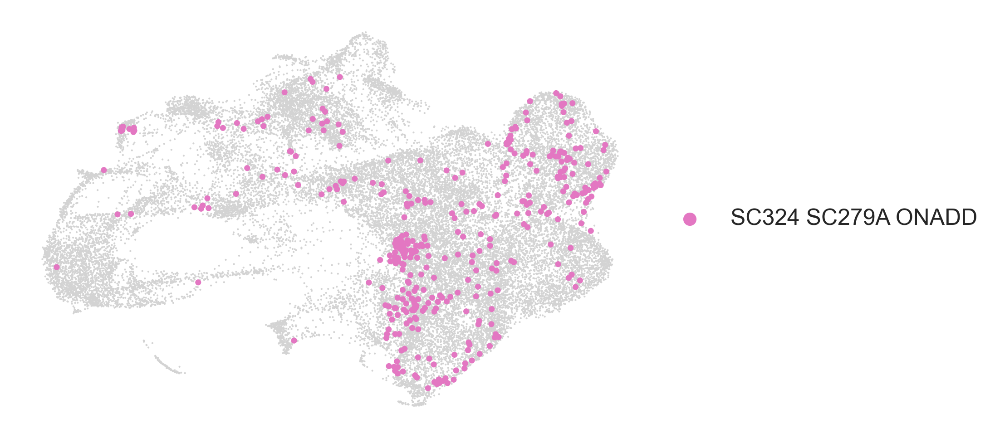

In [30]:
for i in np.unique(adata_mda.obs['sample'].values):
    ax =  scv.pl.scatter(adata_mda, basis = 'umap', show = False, color = 'lightgrey', dpi = 300)
    scv.pl.velocity_embedding_stream(adata_mda[adata_mda.obs['sample'].isin([i])], basis="umap", color = ['sample'], legend_fontsize=12, title="", smooth=0.8, min_mass=4, 
    legend_loc = 'on right', dpi = 300, figsize = (6,5), ax = ax, size=40, zorder = 2, alpha = 1)
    # plt.savefig(f"figures/{i.split('_')[1]}_embedding_stream.pdf")
    

## Plotting top genes

saving figure to file figures/top_gene_fits_emt.png


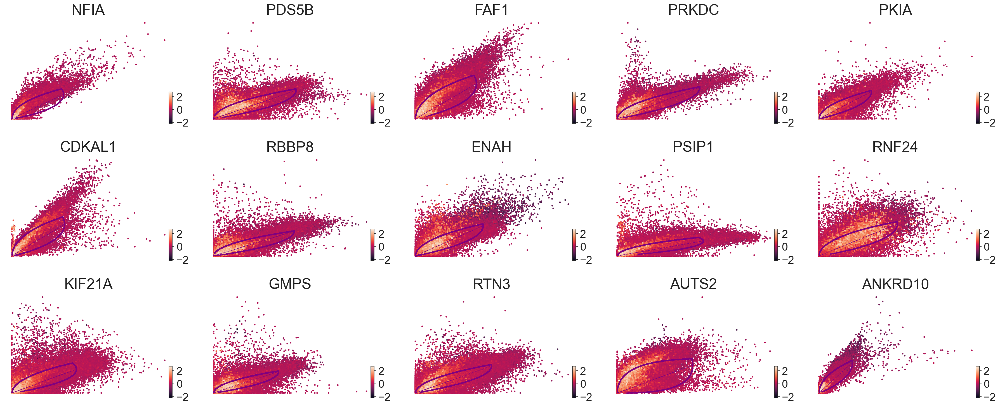

In [34]:
top_genes = adata_mda.var['fit_likelihood'].sort_values(ascending=False).index

scv.pl.scatter(adata_mda, basis=top_genes[:15], ncols=5, frameon=False, color = 'EMT_score', save = "figures/top_gene_fits_emt.png",
               fontsize = 25,size = 30,
               dpi = 150)

saving figure to file figures/top_gene_fits_seurat_clusters.png


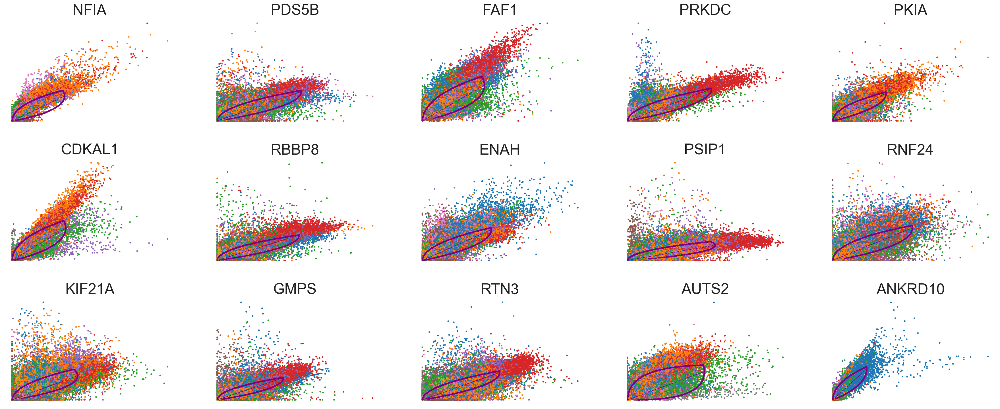

In [36]:
scv.pl.scatter(adata_mda, basis=top_genes[:15], ncols=5, frameon=False, color = 'seurat_clusters', save = "figures/top_gene_fits_seurat_clusters.png",
               fontsize = 25,size = 30,
               dpi = 150)

In [39]:
scv.tl.rank_dynamical_genes(adata_mda, groupby='sample')


In [38]:
df = scv.get_df(adata_mda, 'rank_dynamical_genes/names')
df.head(5)

,SC267_262A_Y905J,SC267_162B_E5ZS8,SC134_142A_FYKY4,SC254_284A_POOVK,SC277_288A_SNFU0,SC134_145A_43LG5,SC324_SC279A_ONADD,SC123_135A_5K9UN,SC123_140A_6SIM9,SC181_151B_WJ6GC,SC229_233A_830HW,SC307_SC149-A_KRGCG
0,RNF24,PDS5B,HLA-DPA1,PDS5B,RNF24,ENAH,RTN3,TMEM14B,RTN3,PDS5B,PDS5B,RNF24
1,PRKDC,RNF24,IQGAP1,TMEM14B,FAF1,FAF1,AUTS2,FAF1,RSRC1,AUTS2,PRKDC,RSRC1
2,SRPK1,ENAH,EZR,MNAT1,KIF21A,AUTS2,PRKDC,MICU2,ENAH,PKIA,RNF24,SRPK1
3,RSRC1,MNAT1,CD44,FAF1,MNAT1,PRKDC,ENAH,RTN3,MAP1B,MNAT1,AUTS2,CD44
4,PCM1,AUTS2,KPNA4,PRKDC,ENAH,PDS5B,RNF24,AUTS2,FAF1,ENAH,MNAT1,ATRX


Trying to set attribute `.layers` of view, copying.


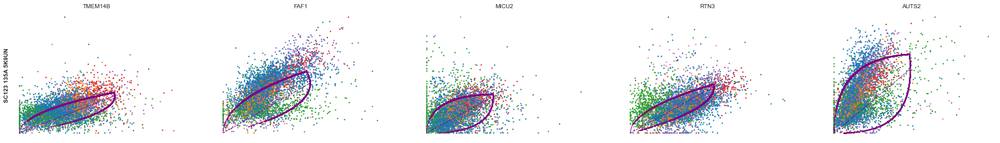

Trying to set attribute `.layers` of view, copying.


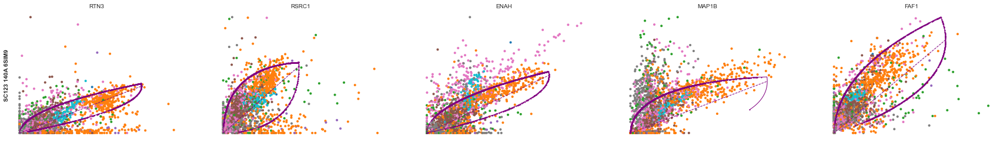

Trying to set attribute `.layers` of view, copying.


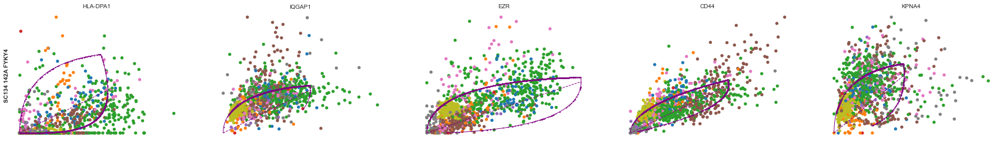

Trying to set attribute `.layers` of view, copying.


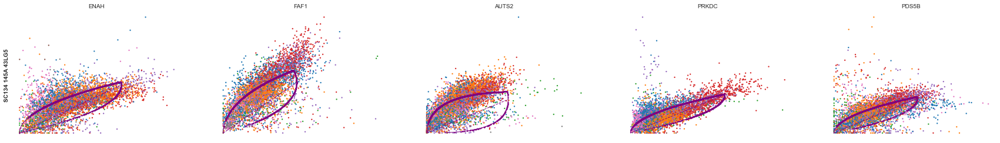

Trying to set attribute `.layers` of view, copying.


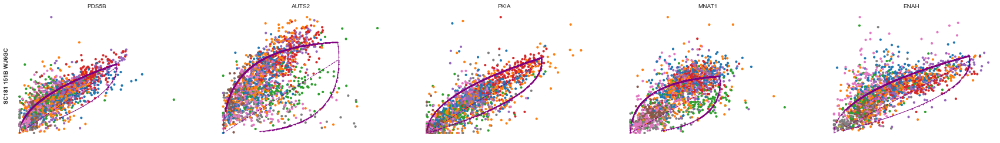

Trying to set attribute `.layers` of view, copying.


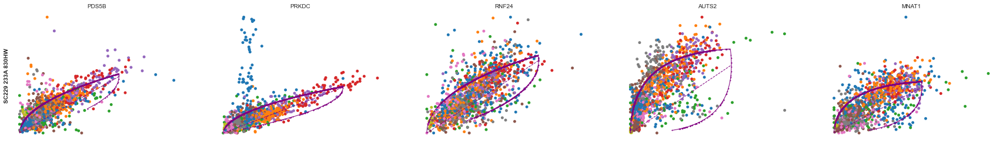

Trying to set attribute `.layers` of view, copying.


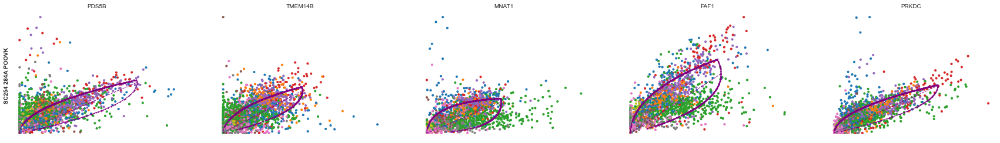

Trying to set attribute `.layers` of view, copying.


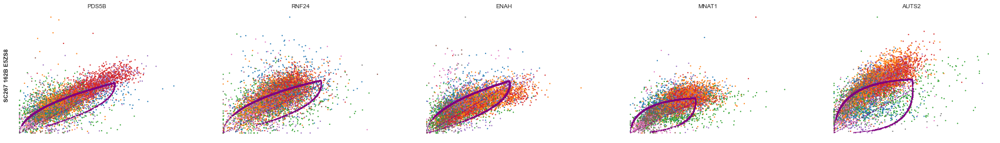

Trying to set attribute `.layers` of view, copying.


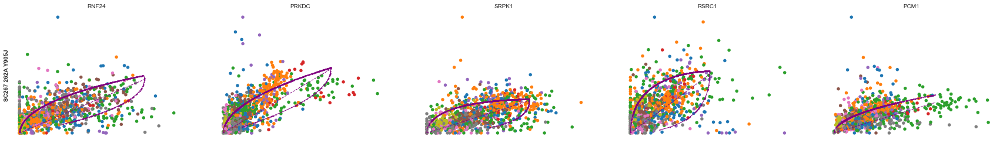

Trying to set attribute `.layers` of view, copying.


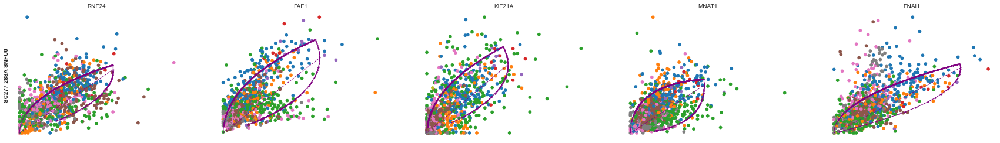

Trying to set attribute `.layers` of view, copying.


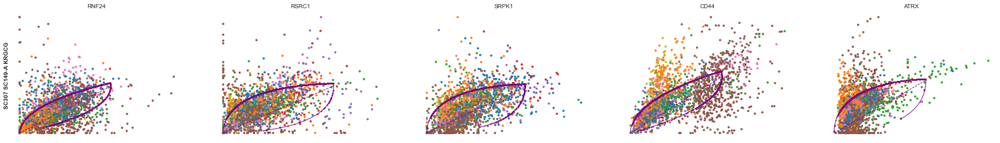

Trying to set attribute `.layers` of view, copying.


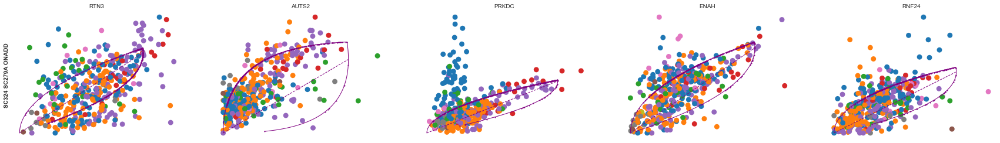

In [45]:
for cluster in np.unique(adata_mda.obs['sample']):
    scv.pl.scatter(adata_mda[adata_mda.obs['sample'].isin([cluster])], df[cluster][:5], ylabel=cluster, frameon=False, color = 'seurat_clusters')

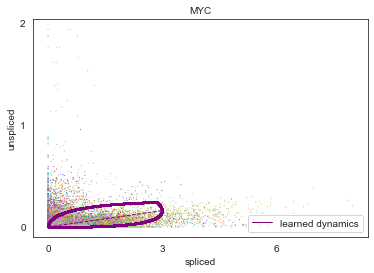

In [51]:
scv.pl.scatter(adata_mda, basis='MYC', color = 'sample')

# CellRank Transition Matrix

In [5]:
vk = VelocityKernel(adata_mda)
vk.compute_transition_matrix()

  0%|          | 0/29841 [00:00<?, ?cell/s]

  0%|          | 0/29841 [00:00<?, ?cell/s]

<VelocityKernel>

In [56]:
from cellrank.tl.estimators import GPCCA

g = GPCCA(vk)
g.compute_schur(n_components=20)
print(g)

GPCCA[n=29841, kernel=<VelocityKernel[softmax_scale=5.87, mode=deterministic, seed=2732, scheme=<CorrelationScheme>]>]


In [58]:
g.compute_macrostates(cluster_key="sample") 


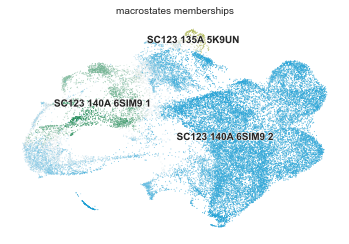

In [59]:
g.plot_macrostates()


saving figure to file ./figures/macrostates.png


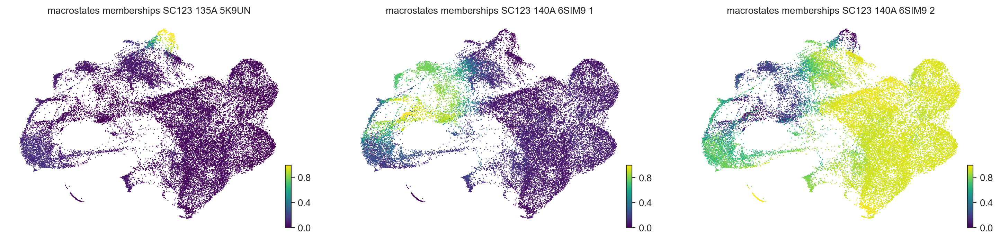

In [64]:
g.plot_macrostates(same_plot=False, dpi = 200, save = './figures/macrostates.png')


saving figure to file ./figures/macrostates_discrete.png


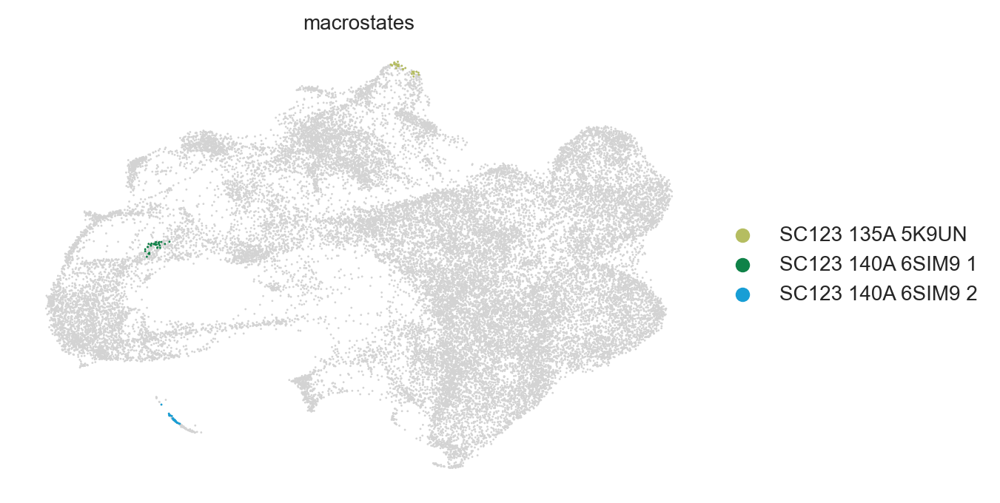

In [65]:
g.plot_macrostates(discrete = True, dpi = 200, save = './figures/macrostates_discrete.png', legend_loc='on right')


In [69]:
g.compute_terminal_states() 


In [ ]:
# g.compute_absorption_probabilities(solver="gmres", use_petsc=True)

In [70]:
scv.tl.paga(
    adata_mda,
    groups="sample",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
)

running PAGA using priors: ['velocity_pseudotime', 'terminal_states_probs']


KeyError: 'Attribute does not exist'

In [72]:
cr.pl.cluster_fates(
    adata_mda,
    mode="paga",
    cluster_key="sample",
    basis="umap",
    legend_kwargs={"loc": "top right out"},
    legend_loc="on data",
    node_size_scale=2,
    edge_width_scale=1,
    max_edge_width=4,
    title="Directed PAGA",figsize = (12, 3),
dpi = 300)

KeyError: "Lineage key `'to_terminal_states'` not found in `adata.obsm`."

# Cell Transport Potential

In [6]:
mb.ps.ctrp_simplified(adata_mda,distance_basis='X_pca', T = vk.transition_matrix)



(29841, 29841)
Eigenvalues:  [1.]
    identified 1 end points
[[2.93273692e-04 1.46064582e-02 6.93308977e-06 ... 3.85289201e-04
  1.85390773e-03 2.72504694e-04]
 [2.10560540e-04 1.36231538e-02 3.97259999e-06 ... 2.01231807e-04
  1.88344264e-03 2.49691230e-04]
 [1.74895114e-04 1.16233189e-02 3.97713251e-06 ... 2.12194390e-04
  1.79478605e-03 2.70933650e-04]
 ...
 [3.36718500e-04 1.48339582e-02 6.75793383e-06 ... 4.48880996e-04
  1.79462372e-03 2.64871171e-04]
 [4.64742164e-04 1.79888005e-02 1.69158976e-05 ... 7.53023848e-04
  2.85386552e-03 3.89960595e-04]
 [1.21657987e-03 2.92134623e-02 1.07373831e-05 ... 1.78549932e-03
  2.10975374e-03 2.22026529e-04]]


<AxesSubplot:title={'center':'ctrp'}>

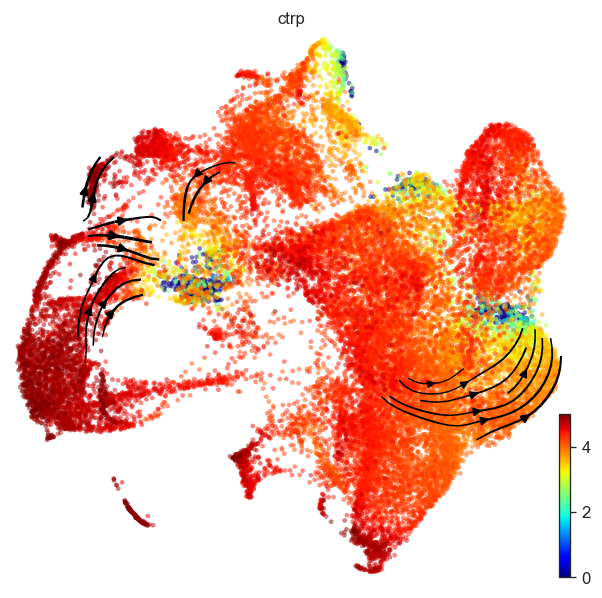

In [98]:
scv.pl.velocity_embedding_stream(adata_mda, color='ctrp', show=False, color_map='jet', alpha=0.5, basis='umap', dpi=120,
                    zorder=1,figsize=(6,6), vmax = 5, min_mass = 4)

In [15]:
adata_mda.obs['absorbing'] = [{True:"True", False:"False"}[i] for i in adata_mda.obs['absorbing']]

In [22]:
adata_mda.uns['None_TM'] = np.array(adata_mda.uns['None_TM'])

In [23]:
adata_mda.write_h5ad("../biopsy_updated/adata_mda_03.h5ad")

In [76]:
# !pip install statannot

## Yap1 and CTRP

yap1_pos                          False      True
SC123_135A.AAACCCACAAAGGCTG-1  4.339600       NaN
SC123_135A.AAACCCACAGCGGATA-1  4.429716       NaN
SC123_135A.AAACCCAGTGTCCGGT-1  4.147460       NaN
SC123_135A.AAACCCATCACCTCTG-1       NaN  4.342347
SC123_135A.AAACCCATCAGAACCT-1       NaN  4.380390
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

False v.s. True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=7.091e-262 U_stat=3.910e+07


(array([0, 1]), [Text(0, 0, 'False'), Text(1, 0, 'True')])

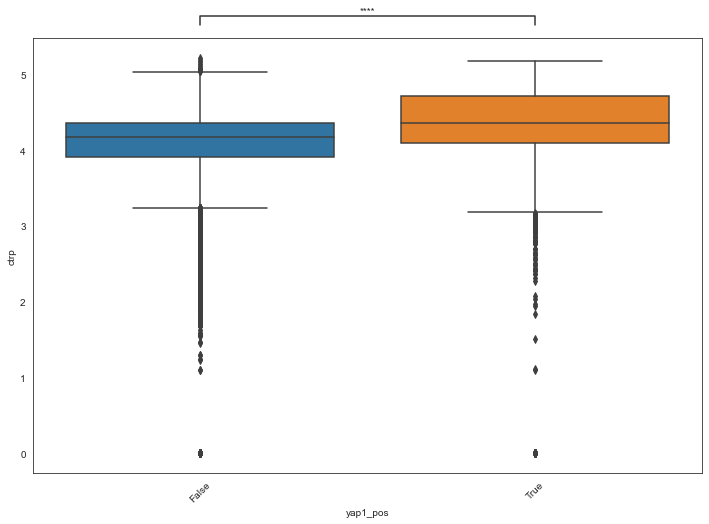

In [30]:
from statannot import add_stat_annotation
df = adata_mda.obs[['yap1_pos','ctrp']].pivot(columns='yap1_pos')
df.columns = df.columns.droplevel(0)
sorted_index = df.median().sort_values().index
print(df.head())
plt.figure(figsize=(12,8))
ax = sns.boxplot(data = adata_mda.obs, x='yap1_pos',y = 'ctrp',#palette=[cp[5],cp[0],cp[2],cp[4],cp[3],cp[1],cp[6],],
                order = sorted_index,)
test_results = add_stat_annotation(ax, data=adata_mda.obs, x='yap1_pos', y='ctrp', order=sorted_index,
                                   box_pairs=[('True', 'False')],
                                   test='Mann-Whitney', text_format='star',
                                   loc='outside', verbose=2)
plt.xticks(rotation = 45)

In [32]:
df = adata_mda.obs[['yap1_pos','ctrp']].pivot(columns='yap1_pos')

df2 = df.copy()
df2['sample'] = adata_mda.obs['sample']
df2.head()

df2 = df2.groupby('sample').mean()

df2['sample'] = df2.index

df2 = pd.melt(df2, id_vars='sample', value_vars = ['False', 'True'])

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

False v.s. True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.985e-03 U_stat=1.100e+01


Text(0.5, 1.0, 'Comparing average CTrP by sample in Yap+ vs Yap- cells')

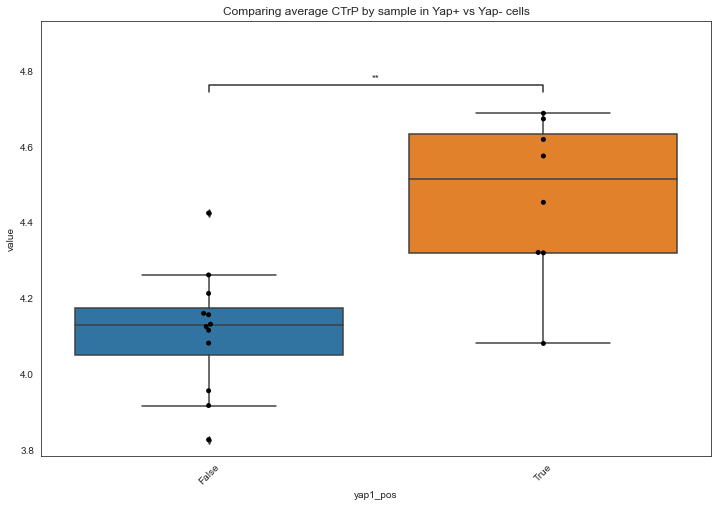

In [62]:
plt.figure(figsize=(12,8))
ax = sns.boxplot(data = df2, x='yap1_pos',y = 'value')
sns.swarmplot(data = df2, x='yap1_pos',y = 'value', color = 'k')
test_results = add_stat_annotation(ax, data=df2, x='yap1_pos', y='value', order=sorted_index,
                                   box_pairs=[('True', 'False')],
                                   test='Mann-Whitney', text_format='star',
                                   loc='inside', verbose=2)
plt.xticks(rotation = 45)
plt.title("Comparing average CTrP by sample in Yap+ vs Yap- cells")

In [34]:
pd.crosstab(adata_mda.obs['sample'], adata_mda.obs['yap1_pos'])

yap1_pos,False,True
sample,,
SC267_262A_Y905J,837,155
SC267_162B_E5ZS8,6303,585
SC134_142A_FYKY4,1044,0
SC254_284A_POOVK,1634,166
SC277_288A_SNFU0,542,364
SC134_145A_43LG5,5463,0
SC324_SC279A_ONADD,380,0
SC123_135A_5K9UN,3457,1954
SC123_140A_6SIM9,1406,420


## EMT and CTRP

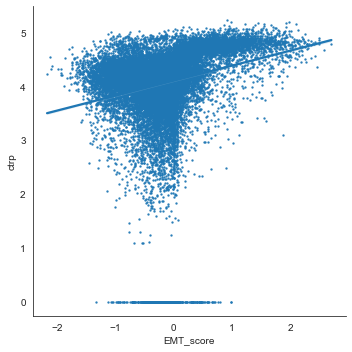

In [76]:
sns.lmplot(data = adata_mda.obs, x = 'EMT_score', y = 'ctrp', scatter_kws={"s": 2})

In [82]:
adata_mda.obs.columns

Index(['sample', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced',
       'initial_size', 'n_counts', 'orig.ident', 'nCount_RNA', 'nFeature_RNA',
       'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'S.Score', 'G2M.Score',
       'Phase', 'integrated_snn_res.0.1', 'seurat_clusters', 'label',
       'cell_id', 'integrated_snn_res.0.05', 'sample_id', 'YAPTAZ_score',
       'EMT_score', 'yap1_pos', 'myc_pos', 'velocity_self_transition',
       'velocity_length', 'velocity_confidence',
       'velocity_confidence_transition', 'end_points', 'col', 'ctrp',
       'absorbing'],
      dtype='object')

## MYC and CTRP

In [89]:
df = adata_mda.obs[['myc_pos','ctrp']].pivot(columns='myc_pos')
df.columns = df.columns.droplevel(0)

df2 = df.copy()
df2['sample'] = adata_mda.obs['sample']
df2.head()


myc_pos,False,True,sample
SC123_135A.AAACCCACAAAGGCTG-1,NaN,4.339600,SC123_135A_5K9UN
SC123_135A.AAACCCACAGCGGATA-1,NaN,4.429716,SC123_135A_5K9UN
SC123_135A.AAACCCAGTGTCCGGT-1,NaN,4.147460,SC123_135A_5K9UN
SC123_135A.AAACCCATCACCTCTG-1,NaN,4.342347,SC123_135A_5K9UN
SC123_135A.AAACCCATCAGAACCT-1,NaN,4.380390,SC123_135A_5K9UN


In [90]:

df2 = df2.groupby('sample').mean()


In [91]:
df2

myc_pos,False,True
sample,,
SC267_262A_Y905J,4.248313,4.347048
SC267_162B_E5ZS8,3.964006,4.056397
SC134_142A_FYKY4,4.237008,4.453015
SC254_284A_POOVK,4.139688,4.349480
SC277_288A_SNFU0,4.236874,4.194856
SC134_145A_43LG5,3.817115,3.959443
SC324_SC279A_ONADD,4.208170,4.043148
SC123_135A_5K9UN,4.067604,4.088901
SC123_140A_6SIM9,4.448506,4.582489


In [92]:

df2['sample'] = df2.index

df2 = pd.melt(df2, id_vars='sample', value_vars = ['False', 'True'])

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

False v.s. True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=3.123e-01 U_stat=5.400e+01


Text(0.5, 1.0, 'Comparing average CTrP by sample in Myc+ vs Myc- cells')

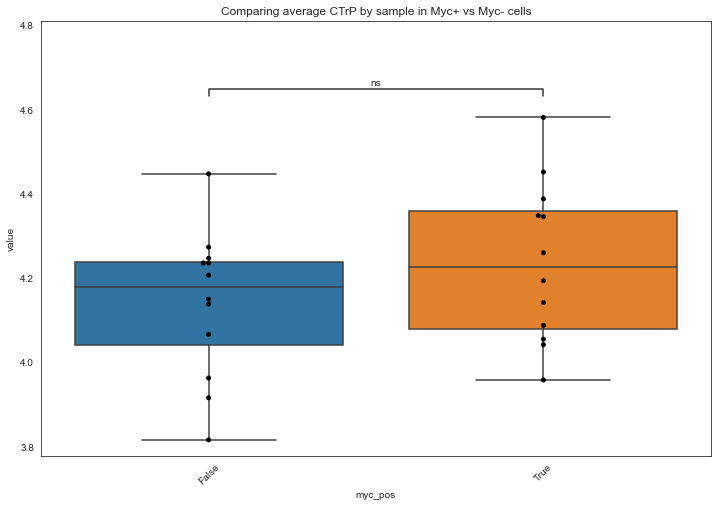

In [94]:
plt.figure(figsize=(12,8))
ax = sns.boxplot(data = df2, x='myc_pos',y = 'value')
sns.swarmplot(data = df2, x='myc_pos',y = 'value', color = 'k')
test_results = add_stat_annotation(ax, data=df2, x='myc_pos', y='value', order=sorted_index,
                                   box_pairs=[('True', 'False')],
                                   test='Mann-Whitney', text_format='star',
                                   loc='inside', verbose=2)
plt.xticks(rotation = 45)
plt.title("Comparing average CTrP by sample in Myc+ vs Myc- cells")

myc_pos                        False      True
SC123_135A.AAACCCACAAAGGCTG-1    NaN  4.339600
SC123_135A.AAACCCACAGCGGATA-1    NaN  4.429716
SC123_135A.AAACCCAGTGTCCGGT-1    NaN  4.147460
SC123_135A.AAACCCATCACCTCTG-1    NaN  4.342347
SC123_135A.AAACCCATCAGAACCT-1    NaN  4.380390
p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

False v.s. True: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=4.847e-58 U_stat=7.551e+07


(array([0, 1]), [Text(0, 0, 'False'), Text(1, 0, 'True')])

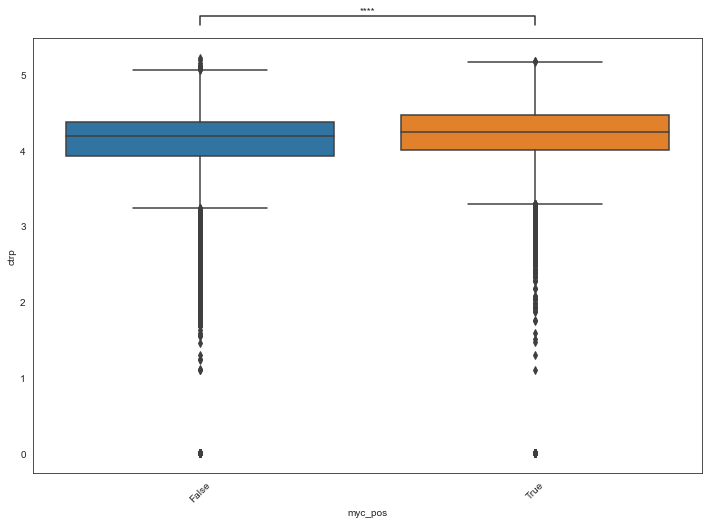

In [96]:
from statannot import add_stat_annotation
df = adata_mda.obs[['myc_pos','ctrp']].pivot(columns='myc_pos')
df.columns = df.columns.droplevel(0)
sorted_index = df.median().sort_values().index
print(df.head())
plt.figure(figsize=(12,8))
ax = sns.boxplot(data = adata_mda.obs, x='myc_pos',y = 'ctrp',#palette=[cp[5],cp[0],cp[2],cp[4],cp[3],cp[1],cp[6],],
                order = sorted_index,)
test_results = add_stat_annotation(ax, data=adata_mda.obs, x='myc_pos', y='ctrp', order=sorted_index,
                                   box_pairs=[('True', 'False')],
                                   test='Mann-Whitney', text_format='star',
                                   loc='outside', verbose=2)
plt.xticks(rotation = 45)

<AxesSubplot:title={'center':'MYC'}>

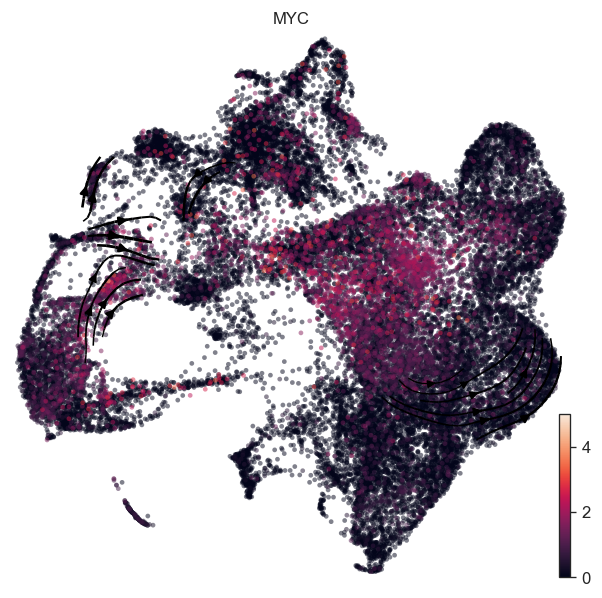

In [101]:
scv.pl.velocity_embedding_stream(adata_mda, color='MYC', show=False,  alpha=0.5, basis='umap', dpi=120,
                    zorder=1,figsize=(6,6), vmax = 5, min_mass = 4)

In [3]:
adata_mda = sc.read_h5ad("../biopsy_updated/adata_mda_03.h5ad")

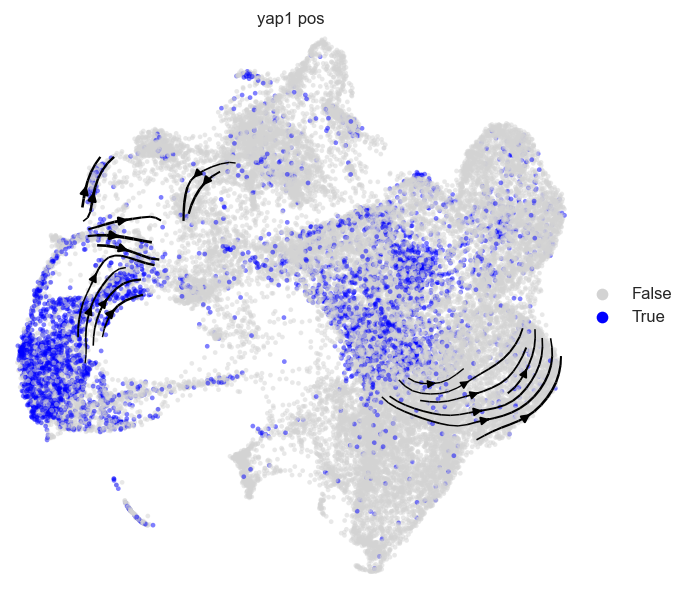

In [8]:
scv.pl.velocity_embedding_stream(adata_mda, color='yap1_pos', alpha=0.5, basis='umap', dpi=120, palette = ['lightgrey','blue'],
                    zorder=1,figsize=(6,6), vmax = 5, min_mass = 4, legend_loc = 'on right')

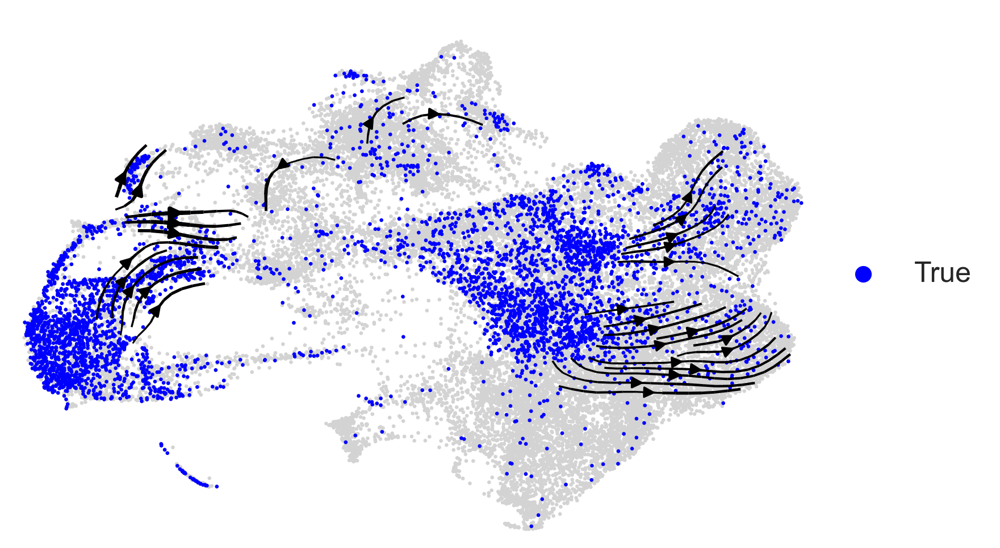

In [14]:
ax =  scv.pl.scatter(adata_mda, basis = 'umap', show = False, color = 'lightgrey', dpi = 300, size = 10)
scv.pl.velocity_embedding_stream(adata_mda[adata_mda.obs['yap1_pos'].isin(['True'])], basis="umap", color = ['yap1_pos'], legend_fontsize=12, title="", smooth=0.8, min_mass=4, 
legend_loc = 'on right', dpi = 300, figsize = (6,5), ax = ax, size=10, zorder = 2, alpha = 1, show = False)
plt.savefig("yap1_pos_velocity_stream.png")

In [107]:
for i in adata_mda.var_names:
    if "YAP" in i:
        print(i)

SYAP1


In [17]:
adata_mda.obs['velocity_length'].to_csv("out/velocity_length.csv")

In [22]:
sample_name = [i.split("_")[1] for i in adata_mda.obs['sample']]

In [24]:
adata_mda.obs['sample_name'] = sample_name

Index(['145A', '162B', '142A', '284A', '135A', '262A', '151B', '233A',
       'SC149-A', '140A', '288A', 'SC279A'],
      dtype='object', name='sample_name')

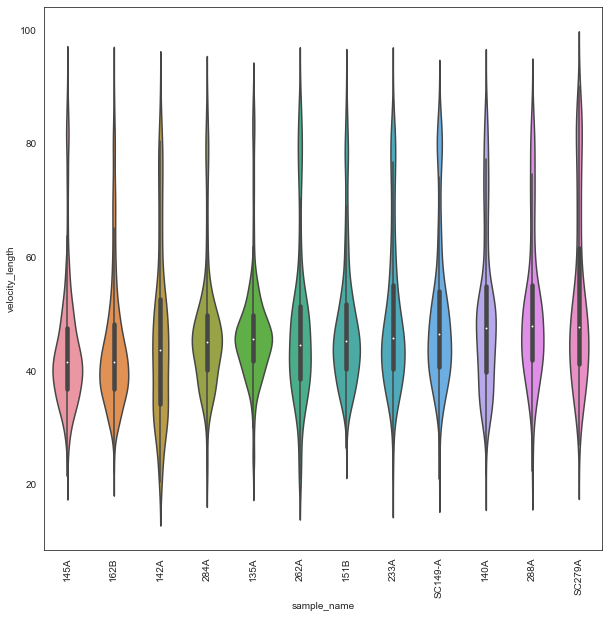

In [34]:
order = adata_mda.obs.groupby("sample_name").mean()['velocity_length'].sort_values().index
plt.figure(figsize = (10,10))
sns.violinplot(data= adata_mda.obs, x = 'sample_name', y = 'velocity_length', order = order)
plt.xticks(rotation = 90)
plt.savefig("figures/velocity_length_vs_sample.pdf")

## PAGA

In [2]:
adata_mda = sc.read_h5ad("../biopsy_updated/adata_mda_03.h5ad")

In [3]:
adata_mda

AnnData object with n_obs × n_vars = 29841 × 7099
    obs: 'sample', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'S.Score', 'G2M.Score', 'Phase', 'integrated_snn_res.0.1', 'seurat_clusters', 'label', 'cell_id', 'integrated_snn_res.0.05', 'sample_id', 'YAPTAZ_score', 'EMT_score', 'yap1_pos', 'myc_pos', 'velocity_self_transition', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition', 'end_points', 'col', 'ctrp', 'absorbing'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'fit_r2', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'velocity_genes'
    uns: 'None_TM', 'myc_pos_colors', 'neighbors', 'recover_dynamics', 'sample_colors', 'vel

In [6]:
scv.tl.paga(adata_mda, groups = 'seurat_clusters')

computing terminal states
    identified 8 regions of root cells and 1 region of end points .
    finished (0:00:10) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:09) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


In [8]:
df = scv.get_df(adata_mda, 'paga/transitions_confidence', precision=2).T
df.style.background_gradient(cmap='Blues').format('{:.2g}')


,0,1,2,3,4,5,6,7,8,9
0,0,0,0,0.67,0.076,0,0,0,0,0
1,0,0,0,0.69,0,0,0,0,0,0
2,0,0,0,0.11,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0.027,0.027,0
6,0.089,0,0,0,0,0,0,0,0,0
7,0,0,0.12,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0.031,0,0,0,0


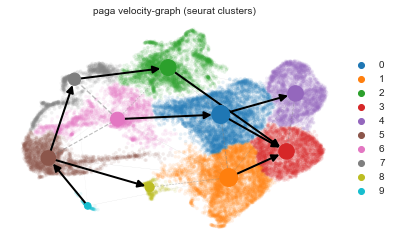

In [9]:
scv.pl.paga(adata_mda, basis='umap_mda', size=50, alpha=.1,
            min_edge_width=2, node_size_scale=1.5)

<AxesSubplot:xlabel='ctrp', ylabel='Count'>

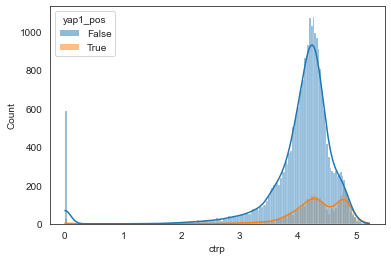

In [14]:
sns.histplot(data = adata_mda.obs, x = 'ctrp', hue = 'yap1_pos', kde = True)

<AxesSubplot:xlabel='ctrp', ylabel='Density'>

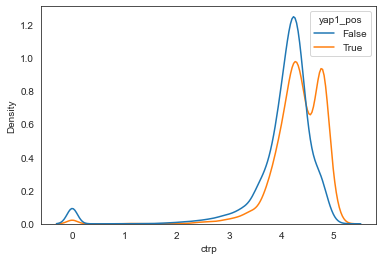

In [15]:
sns.kdeplot(data = adata_mda.obs, x = 'ctrp', hue = 'yap1_pos', common_norm = False)